In [1]:
#wave 파일은 음압 시계열 데이터를 저장하는 가장 기본적인 파일 형식
# 보통 초당 44100번 음압을 측정하고 −32768∼32767(=215)까지의 2바이트(bytes) 숫자로 기록
import share.myAudio as ma
import numpy as np
import matplotlib.pylab as plt
import scipy as sp
from matplotlib import font_manager,rc
from IPython.display import Audio
from IPython.core.display import display

print(sp.__file__)

#마이너스 기호 표시
plt.rcParams['axes.unicode_minus'] = False

#한글처리를위해폰트설정
font_name = font_manager.FontProperties(fname="c:/Windows/Fonts/malgun.ttf").get_name()
rc('font',family=font_name)

c:\Anaconda3\lib\site-packages\scipy\__init__.py


In [2]:
def single_tone(frequecy, sampling_rate=44100, duration=1):
    # frequency: 주파수
    # sampling_rate: 초당 샘플링 데이터 수. 디폴트 44100
    # duration: 지속 시간. 단위 초. 디폴트 1초
    t = np.linspace(0, duration, int(sampling_rate))
    y = np.sin(2 * np.pi * frequecy * t)
    return y

notes = 'C,C#,D,D#,E,F,F#,G,G#,A,A#,B,C'.split(',')
freqs = 261.62 * 2**(np.arange(0, len(notes)) / 12.)
octave = np.hstack([single_tone(f) for f in freqs])

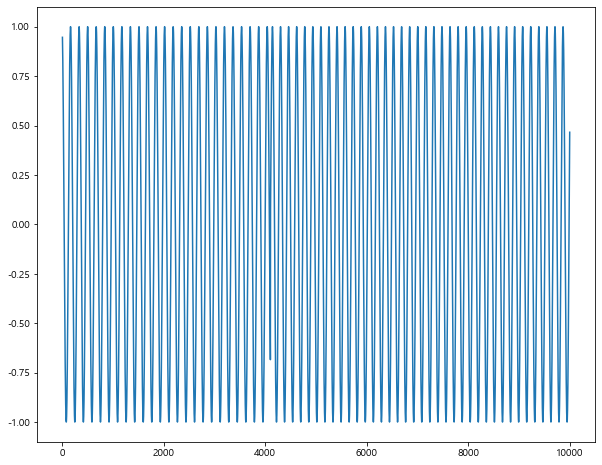

In [3]:
import scipy.io.wavfile as siw

# 초당 샘플링 데이터 수 
sampling_rate = 44100
siw.write('wav/octave.wav', sampling_rate, octave)

sr, y_read = siw.read('wav/octave.wav')
# sr == sampling_rate

plt.figure(figsize=(10,8))
plt.plot(y_read[40000:50000])
plt.show()

In [4]:
samplerate, data = sp.io.wavfile.read('wav/octave.wav')
ma.Audio(data, samplerate)

In [5]:
def plotwave(fs, signal, maxf=None):
    """Visualize (a segment of) a wave file."""
    # maxf = maximum number of frames
    frames = sp.arange(signal.size)   # x-axis
    if maxf:
        plt.plot(frames[:maxf], signal[:maxf])
        plt.xticks(sp.arange(0, maxf, 0.5*fs), sp.arange(0, maxf/fs, 0.5))
        plt.show()
    else:
        plt.plot(frames, signal)
        plt.xticks(sp.arange(0, signal.size, 0.5*fs), sp.arange(0, signal.size/fs, 0.5))
        plt.show()

C:\Users\TJOEUN~1\AppData\Local\Temp/ipykernel_2560/306613117.py:7: DeprecationWarning: scipy.arange is deprecated and will be removed in SciPy 2.0.0, use numpy.arange instead
  frames = sp.arange(duration*fs)
C:\Users\TJOEUN~1\AppData\Local\Temp/ipykernel_2560/306613117.py:10: DeprecationWarning: scipy.sin is deprecated and will be removed in SciPy 2.0.0, use numpy.sin instead
  note2signal = {note: amplitude * sp.sin(2*sp.pi*frames*note2freq[note]/fs) for note in note2freq}
C:\Users\TJOEUN~1\AppData\Local\Temp/ipykernel_2560/306613117.py:11: DeprecationWarning: scipy.ones is deprecated and will be removed in SciPy 2.0.0, use numpy.ones instead
  note2signal['sp'] = sp.ones(int(duration*fs/4))
C:\Users\TJOEUN~1\AppData\Local\Temp/ipykernel_2560/1951378167.py:4: DeprecationWarning: scipy.arange is deprecated and will be removed in SciPy 2.0.0, use numpy.arange instead
  frames = sp.arange(signal.size)   # x-axis
C:\Users\TJOEUN~1\AppData\Local\Temp/ipykernel_2560/1951378167.py:7: Depre

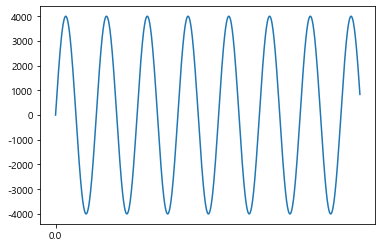

In [6]:
# in Hz (waves per second)
note2freq = {'C4':261.6, 'D4':293.7, 'E4':329.6, 'F4':349.2, 'G4':392.0, 'A4':440.0, 'B4':493.9, 'C5':523.3} 

# basic parameters
duration = .6  # in seconds
fs = 44100  # sampling rate
frames = sp.arange(duration*fs)
amplitude = 4000   

note2signal = {note: amplitude * sp.sin(2*sp.pi*frames*note2freq[note]/fs) for note in note2freq}
note2signal['sp'] = sp.ones(int(duration*fs/4))

note = 'E4'
plotwave(fs, note2signal[note], 1000)  # visualize first 1000 frames

siw.write('wav/sine'+str(note)+'.wav', fs, note2signal[note])  # write to file
ma.Audio(note2signal[note], fs)

In [7]:
allnotes = sp.hstack([note2signal[note] for note in 'sp C4 D4 E4 F4 G4 A4 B4 C5 sp'.split()])
sp.io.wavfile.write('wav/cscale.wav', fs, allnotes)
ma.Audio(allnotes, fs)

C:\Users\TJOEUN~1\AppData\Local\Temp/ipykernel_2560/1156983437.py:1: DeprecationWarning: scipy.hstack is deprecated and will be removed in SciPy 2.0.0, use numpy.hstack instead
  allnotes = sp.hstack([note2signal[note] for note in 'sp C4 D4 E4 F4 G4 A4 B4 C5 sp'.split()])


In [8]:
twinkle = sp.hstack([note2signal[note] for note in 'sp C4 sp C4 sp G4 sp G4 sp A4 sp A4 sp G4'.split()])
sp.io.wavfile.write('wav/twinkle.wav', fs, twinkle)
ma.Audio(twinkle, fs)

C:\Users\TJOEUN~1\AppData\Local\Temp/ipykernel_2560/8265046.py:1: DeprecationWarning: scipy.hstack is deprecated and will be removed in SciPy 2.0.0, use numpy.hstack instead
  twinkle = sp.hstack([note2signal[note] for note in 'sp C4 sp C4 sp G4 sp G4 sp A4 sp A4 sp G4'.split()])


In [9]:
#전화는 DTMF(Dual-tone multi-frequency) 방식이라는 두 싱글톤 조합의 음향 신호로 전화번호를 입력받는다.
#        1209Hz 1336Hz 1477Hz 1633Hz
#   697 Hz	1	   2	  3	    A
#   770 Hz	4	   5	  6 	B
#   852 Hz	7	   8	  9	    C
#   941 Hz	*	   0	  #	    D

In [10]:
#동물 음성 처리
# Scipy.io 에 포함된 wavfile 함수를 사용 -> 스피커로 출력
#import sounddevice as sd
dog_sound_file = 'C:/data/cats_dog/cats_dogs/dog_barking_45.wav'
samplerate, data = sp.io.wavfile.read(dog_sound_file)
times = np.arange(len(data)) / float(samplerate)
#sd.play(data, samplerate)
Audio(dog_sound_file, autoplay=True)

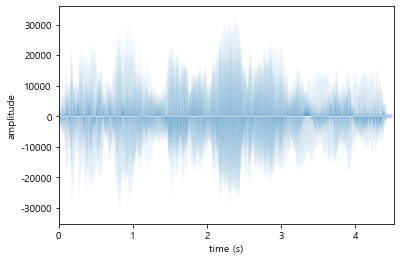

In [11]:
plt.fill_between(times, data)
plt.xlim(times[0], times[-1])
plt.xlabel('time (s)')
plt.ylabel('amplitude')
plt.show()

In [12]:
#Sample rate: 샘플의 빈도 수, 즉 1초당 추출되는 샘플 개수
# 오디오에서 44.1KHz(44100Hz), 22KHz(22050Hz)를 뜻함.
print('sampling rate: ', samplerate)
print('time : ', times[-1])

sampling rate:  16000
time :  4.517375
